# Predictive Modeling and Data Enhancement for Optimal User Interaction

## Table of Contents

* [Business Problem](#business-problem)
* [Task](#task)
* [Data Description](#data-description)
* [Load and View the Data](#load-and-view-the-data)
* [Data Engineering](#data-engineering)
* [Exploratory Data Analysis](#exploratory-data-analysis)
* [Feature Engineering](#feature-engineering)
    * [One-Hot Encoding](#one-hot-encoding)
    * [MinMaxScaler](#minmaxscaler)
* [Model Traning and Predictions](#model-traning-and-predictions)
     * [Predicting Interactions With 3 Days](#predicting-interactions-with-3-days)
     * [Predicting Interactions With 7 Days](#predicting-interactions-with-7-days)
* [Deep Learning](#deep-learning)
* [Concluding Observations](#concluding-observations) 

# Business Problem

The business aims to enhance the interaction and engagement of properties on the NoBroker platform. To achieve this, the company seeks to address specific challenges and opportunities identified in the provided datasets

<div style="text-align:center">
    <img src="https://www.nobroker.in/blog/wp-content/uploads/2020/07/property-mgt-1.jpg" alt="Image Alt Text" />
</div>


1. **Predictive Model for Interaction Frequency:**
   - Develop a predictive model to estimate the number of interactions a property is likely to receive within different time frames after activation (specifically 3 days and 7 days).
   - Leverage features such as activation date, BHK type, locality, property size, age, rent, apartment type, etc., to optimize the prediction accuracy.
   - Allow flexibility for incorporating additional time intervals into the prediction model.

2. **Property Photo Data Enhancement:**
   - Clean and rectify corrupted data in the `property_photos.tsv` dataset, specifically in the `photo_urls` column.
   - Extract the accurate count of photos uploaded for each property by transforming the corrupted string representations into valid JSON arrays.
   - Differentiate between properties with uploaded photos and those without (NULL/NaN values indicate absence of photos).

3. **Interaction Timestamp Analysis:**
   - Utilize the `property_interactions.csv` dataset to understand the timestamps of user interactions with properties.
   - Quantify the frequency of interactions by counting the occurrences of each property in the interaction dataset.
   - Incorporate interaction timestamps along with activation dates and other property features to gain insights into user behavior and optimize property recommendations.

**Objective:**
   - Improve the overall user experience by optimizing property recommendations and increasing user engagement on the NoBroker platform.
   - Enhance the accuracy of predicting property interactions to provide users with relevant and timely recommendations.
   - Ensure that the count of property photos is accurately represented, aiding users in making informed decisions about potential properties.


# Task
Our goal is to develop a predictive model capable of estimating the quantity of interactions a property is expected to receive over a specified time frame. To simplify, let's focus on forecasting the number of interactions within both 3 days and 7 days after the property's activation. However, feel free to introduce additional time intervals to address this challenge.

# Data Description

1. **`property_data_set.csv`:**
   - Contains properties data with various attributes.
   - Features include activation date, BHK type, locality, property size, age, rent, apartment type, etc.
   - The `activation_date` indicates when a property was activated on NoBroker.
   - Binary-valued fields (e.g., lift, gym) signify presence (1) or absence (0).
   - Utilize this dataset to engineer features for your study.

2. **`property_photos.tsv`:**
   - Data on the number of photos for each property.
   - The `photo_urls` column contains string values that need parsing.
   - Values are supposed to represent a JSON array of images, but some are corrupted.
   - Correct by adding missing double quotes before 'title' and removing extra double quotes and `\\`.
   - Objective: Determine the number of photos for each property.
   - NULL/NaN values indicate no photos (photo_count = 0).

3. **`property_interactions.csv`:**
   - Contains timestamps of interactions on properties.
   - Each `request_date` represents the timestamp of a unique valid interaction.
   - Interaction includes contact with the owner, resulting in the user receiving the owner's contact phone number.
   - Count occurrences of each property to find the number of interactions.
   - Combine `request_date` with `activation_date` and other features for your study.

# Load and View the Data
Imported necessary libraries and loaded properties, interactions, and property photos data from CSV and TSV files into Pandas DataFrames.

In [9]:
# Import necessary libraries
import pandas as pd 

# Read properties data
# Loading data from 'property_data_set.csv'
properties_data = pd.read_csv('datasets/property_data_set.csv',
                            parse_dates=['activation_date'], infer_datetime_format=True, dayfirst=True)

# Read interaction data
# Loading data from 'property_interactions.csv'
interaction_data = pd.read_csv('datasets/property_interactions.csv',
                            parse_dates=['request_date'], infer_datetime_format=True, dayfirst=True)

# Read property photos data
# Loading data from 'property_photos.tsv'
photos_data = pd.read_table('datasets/property_photos.tsv')


In [10]:
properties_data.head()

,property_id,type,activation_date,bathroom,floor,total_floor,furnishing,gym,latitude,longitude,...,lift,locality,parking,property_age,property_size,swimming_pool,pin_code,rent,deposit,building_type
0,ff808081469fd6e20146a5af948000ea,BHK2,2017-03-09 14:36:00,1,3,4.0,SEMI_FURNISHED,1,12.876174,77.596571,...,1,Hulimavu,BOTH,2,850,1,560076.0,12000,120000,AP
1,ff8080814702d3d10147068359d200cd,BHK2,2017-03-07 12:02:00,2,4,11.0,SEMI_FURNISHED,1,13.018444,77.678122,...,1,Ramamurthy Nagar,BOTH,1,1233,1,560016.0,20000,150000,AP
2,ff808081470c645401470fb03f5800a6,BHK2,2017-03-10 13:43:00,2,0,4.0,NOT_FURNISHED,1,12.975072,77.665865,...,1,GM Palya,FOUR_WHEELER,0,1200,0,560075.0,15000,75000,AP
3,ff808081470c6454014715eaa5960281,BHK3,2017-03-09 22:16:00,2,3,4.0,SEMI_FURNISHED,0,12.888169,77.591282,...,0,Arakere,BOTH,1,1300,0,560076.0,17000,150000,AP
4,ff808081474aa867014771a0298f0aa6,BHK1,2017-03-15 18:29:00,1,1,2.0,SEMI_FURNISHED,0,12.990243,77.712962,...,0,Hoodi,BOTH,4,450,0,560048.0,6500,40000,IF


In [11]:
photos_data.head()

,property_id,photo_urls
0,ff808081469fd6e20146a5af948000ea,"[{\title\"":\""Balcony\"",\""name\"":\""IMG_20131006..."
1,ff8080814702d3d10147068359d200cd,NaN
2,ff808081470c645401470fb03f5800a6,"[{\title\"":\""Bedroom\"",\""name\"":\""ff808081470c..."
3,ff808081470c6454014715eaa5960281,"[{\title\"":\""Bedroom\"",\""name\"":\""Screenshot_7..."
4,ff808081474aa867014771a0298f0aa6,"[{\title\"":\""Other\"",\""name\"":\""ff808081474aa8..."


In [12]:
interaction_data.head()

,property_id,request_date
0,ff808081469fd6e20146a5af948000ea,2017-03-10 17:42:34
1,ff808081469fd6e20146a5af948000ea,2017-03-09 15:51:17
2,ff808081469fd6e20146a5af948000ea,2017-03-10 17:30:22
3,ff808081469fd6e20146a5af948000ea,2017-03-11 17:48:46
4,ff8080814702d3d10147068359d200cd,2017-03-30 19:59:15


In [13]:
# Print shape (num. of rows, num. of columns) of all data
# Print the shape of properties data
print('Properties Data Shape:', properties_data.shape)

# Print the shape of property photos data
print('Photos Data Shape:', photos_data.shape)

# Print the shape of interaction data
print('Interaction Data Shape:', interaction_data.shape)


Properties Data Shape: (28888, 21)
Photos Data Shape: (28888, 2)
Interaction Data Shape: (170611, 2)


In [14]:
# Display data types of columns in the photos data
# This prints the data types of each column in the photos data
print('Data Types of Columns in Photos Data:')
print(photos_data.dtypes)


Data Types of Columns in Photos Data:
property_id    object
photo_urls     object
dtype: object


In [15]:
# Count the number of NaN values in the photos data
# This prints the count of NaN values in each column of the photos data
nan_counts_photos_data = photos_data.isna().sum()
print('Number of NaN Values in Photos Data:')
print(nan_counts_photos_data)


Number of NaN Values in Photos Data:
property_id        0
photo_urls     11022
dtype: int64


# Data Engineering

Corrected and converted a corrupted JSON entry in the 'photo_urls' column of the 'photos_data' DataFrame.

In [16]:
import json

# Sample JSON correction for the first entry in the 'data_sample' DataFrame
json_text_before = photos_data['photo_urls'][0]

# Print the original JSON text before correction
print('Before Correction:\n\n', json_text_before)

# Try to replace corrupted values, then convert to JSON
json_text_after = json_text_before.replace('\\', '').replace('{title', '{"title').replace(']"', ']')

# Print the corrected and converted JSON
print("\n\nAfter correction and converted to JSON:\n\n", json.loads(json_text_after))

Before Correction:

 [{\title\":\"Balcony\",\"name\":\"IMG_20131006_120837.jpg\",\"imagesMap\":{\"original\":\"ff808081469fd6e20146a5af948000ea_65149_original.jpg\",\"thumbnail\":\"ff808081469fd6e20146a5af948000ea_65149_thumbnail.jpg\",\"medium\":\"ff808081469fd6e20146a5af948000ea_65149_medium.jpg\",\"large\":\"ff808081469fd6e20146a5af948000ea_65149_large.jpg\"},\"displayPic\":false},{\"title\":\"Bathroom\",\"name\":\"IMG_20131006_120734.jpg\",\"imagesMap\":{\"original\":\"ff808081469fd6e20146a5af948000ea_63511_original.jpg\",\"thumbnail\":\"ff808081469fd6e20146a5af948000ea_63511_thumbnail.jpg\",\"medium\":\"ff808081469fd6e20146a5af948000ea_63511_medium.jpg\",\"large\":\"ff808081469fd6e20146a5af948000ea_63511_large.jpg\"},\"displayPic\":false},{\"title\":\"Bedroom\",\"name\":\"IMG_20131006_120643.jpg\",\"imagesMap\":{\"original\":\"ff808081469fd6e20146a5af948000ea_16708_original.jpg\",\"thumbnail\":\"ff808081469fd6e20146a5af948000ea_16708_thumbnail.jpg\",\"medium\":\"ff808081469fd6e201

Applied a correction function to the 'photo_urls' column in the 'photos_data' DataFrame, creating a new 'photo_count' column with the count of photos after correcting any corrupted JSON entries.

In [17]:
import json
import numpy as np
import pandas as pd

# Function to correct corrupted JSON and get count of photos
def correct_and_count_photos(x):
    # If value is null, put count with 0 photos
    if pd.isna(x) or x == 'NaN':
        return 0
    else:
        try:
            # Replace corrupted values, then convert to JSON and get count of photos
            json_content = x.replace('\\', '').replace('{title', '{"title').replace(']"', ']')
            print("Corrected JSON Content:", json_content)
            return len(json.loads(json_content))
        except json.JSONDecodeError as e:
            print("Error in JSON Decoding:", e)
            return 0

# Apply the corrected function to create a new 'photo_count' column in 'photos_data'
photos_data['photo_count'] = photos_data['photo_urls'].apply(correct_and_count_photos)


Corrected JSON Content: [{"title":"Balcony","name":"IMG_20131006_120837.jpg","imagesMap":{"original":"ff808081469fd6e20146a5af948000ea_65149_original.jpg","thumbnail":"ff808081469fd6e20146a5af948000ea_65149_thumbnail.jpg","medium":"ff808081469fd6e20146a5af948000ea_65149_medium.jpg","large":"ff808081469fd6e20146a5af948000ea_65149_large.jpg"},"displayPic":false},{"title":"Bathroom","name":"IMG_20131006_120734.jpg","imagesMap":{"original":"ff808081469fd6e20146a5af948000ea_63511_original.jpg","thumbnail":"ff808081469fd6e20146a5af948000ea_63511_thumbnail.jpg","medium":"ff808081469fd6e20146a5af948000ea_63511_medium.jpg","large":"ff808081469fd6e20146a5af948000ea_63511_large.jpg"},"displayPic":false},{"title":"Bedroom","name":"IMG_20131006_120643.jpg","imagesMap":{"original":"ff808081469fd6e20146a5af948000ea_16708_original.jpg","thumbnail":"ff808081469fd6e20146a5af948000ea_16708_thumbnail.jpg","medium":"ff808081469fd6e20146a5af948000ea_16708_medium.jpg","large":"ff808081469fd6e20146a5af948000e

Removed the "photo_urls" column from the 'photos_data' DataFrame.

In [18]:
del photos_data["photo_urls"]

In [19]:
photos_data

,property_id,photo_count
0,ff808081469fd6e20146a5af948000ea,7
1,ff8080814702d3d10147068359d200cd,0
2,ff808081470c645401470fb03f5800a6,12
3,ff808081470c6454014715eaa5960281,9
4,ff808081474aa867014771a0298f0aa6,7
...,...,...
28883,ff8081815b1fdda8015b1fe675ae0146,0
28884,ff8081815b1fdda8015b1ffee8a305d2,0
28885,ff8081815b1fdda8015b2000369205fd,0
28886,ff8081815b200540015b20158b0103c9,0


Merged 'properties_data' and 'interaction_data' DataFrames on 'property_id,' extracting a subset with columns 'property_id,' 'request_date,' and 'activation_date,' and displayed the first 5 rows.

In [20]:
# Merge properties data with interactions data on property_id
merged_data = pd.merge(properties_data, interaction_data, on='property_id')[['property_id', 'request_date', 'activation_date']]
merged_data.head(5)


,property_id,request_date,activation_date
0,ff808081469fd6e20146a5af948000ea,2017-03-10 17:42:34,2017-03-09 14:36:00
1,ff808081469fd6e20146a5af948000ea,2017-03-09 15:51:17,2017-03-09 14:36:00
2,ff808081469fd6e20146a5af948000ea,2017-03-10 17:30:22,2017-03-09 14:36:00
3,ff808081469fd6e20146a5af948000ea,2017-03-11 17:48:46,2017-03-09 14:36:00
4,ff8080814702d3d10147068359d200cd,2017-03-30 19:59:15,2017-03-07 12:02:00


Calculated the time difference in days between the 'request_date' and 'activation_date,' storing the result in a new 'request_day' column in the 'merged_data' DataFrame.

In [21]:
# Calculate the time between request and activation date
merged_data['request_day'] = (merged_data['request_date'] - merged_data['activation_date']) / np.timedelta64(1, 'D')
merged_data.head()

,property_id,request_date,activation_date,request_day
0,ff808081469fd6e20146a5af948000ea,2017-03-10 17:42:34,2017-03-09 14:36:00,1.129560
1,ff808081469fd6e20146a5af948000ea,2017-03-09 15:51:17,2017-03-09 14:36:00,0.052280
2,ff808081469fd6e20146a5af948000ea,2017-03-10 17:30:22,2017-03-09 14:36:00,1.121088
3,ff808081469fd6e20146a5af948000ea,2017-03-11 17:48:46,2017-03-09 14:36:00,2.133866
4,ff8080814702d3d10147068359d200cd,2017-03-30 19:59:15,2017-03-07 12:02:00,23.331424


Counted the number of requests within the first 3 days for each property, creating a dataset ('requests_within_3_days') with property IDs and corresponding request counts within that timeframe.

In [22]:
# Get a count of requests in the first 3 days
requests_within_3_days = merged_data[merged_data['request_day'] < 3].groupby('property_id').agg({'request_day': 'count'})

# Show every property id with the number of requests in the first 3 days
requests_within_3_days = requests_within_3_days.rename({'request_day': 'request_day_within_3_days'}, axis=1).reset_index()

# Dataset with the number of requests within 3 days
requests_within_3_days


,property_id,request_day_within_3_days
0,ff808081469fd6e20146a5af948000ea,4
1,ff8080814702d3d10147068359d200cd,3
2,ff808081470c645401470fb03f5800a6,15
3,ff808081470c6454014715eaa5960281,5
4,ff808081474aa867014771a0298f0aa6,25
...,...,...
13205,ff8081815b1fdda8015b1fdf585c004b,2
13206,ff8081815b1fdda8015b1fe675ae0146,5
13207,ff8081815b1fdda8015b1ffee8a305d2,2
13208,ff8081815b200540015b20158b0103c9,2


Defined a function 'categorize_numbers(x)' to categorize numbers as 'cat_1_to_2' for 1 and 2, 'cat_3_to_5' for 3, 4, and 5, and 'cat_above_5' for any other number.

In [23]:
def categorize_numbers(x):
    if x in [1, 2]:
        return 'cat_1_to_2'
    elif x in [3, 4, 5]:
        return 'cat_3_to_5'
    else:
        return 'cat_above_5'


Applied the 'categorize_numbers' function to the 'request_day_within_3_days' column in the 'requests_within_3_days' DataFrame, creating a new 'categories_3day' column, and displayed the first 3 rows of the resulting DataFrame.

In [24]:
# Apply the categorize_numbers function to create a new column 'categories_3day'
requests_within_3_days['categories_3day'] = requests_within_3_days['request_day_within_3_days'].apply(categorize_numbers)

# Display the first 3 rows of the resulting DataFrame
requests_within_3_days.head(3)


,property_id,request_day_within_3_days,categories_3day
0,ff808081469fd6e20146a5af948000ea,4,cat_3_to_5
1,ff8080814702d3d10147068359d200cd,3,cat_3_to_5
2,ff808081470c645401470fb03f5800a6,15,cat_above_5


Printed the value counts for the 'categories_3day' column in the 'requests_within_3_days' DataFrame.

In [25]:
# Get value counts for the 'categories_3day' column
categories_count = requests_within_3_days['categories_3day'].value_counts()

# Display the value counts
print(categories_count)


cat_1_to_2     8681
cat_3_to_5     3049
cat_above_5    1480
Name: categories_3day, dtype: int64


Counted the number of requests within the first 7 days for each property, creating a dataset ('requests_within_7_days') with property IDs and corresponding request counts within that timeframe.

In [26]:
# Get a count of requests in the first 7 days
requests_within_7_days = merged_data[merged_data['request_day'] < 7].groupby('property_id').agg({'request_day': 'count'})

# Show every property id with the number of requests in the first 7 days
requests_within_7_days = requests_within_7_days.rename({'request_day': 'request_day_within_7_days'}, axis=1).reset_index()

# Dataset with the number of requests within 7 days
requests_within_7_days


,property_id,request_day_within_7_days
0,ff808081469fd6e20146a5af948000ea,4
1,ff8080814702d3d10147068359d200cd,5
2,ff808081470c645401470fb03f5800a6,22
3,ff808081470c6454014715eaa5960281,7
4,ff808081474aa867014771a0298f0aa6,52
...,...,...
17381,ff8081815b1fdda8015b1fe675ae0146,8
17382,ff8081815b1fdda8015b1ffee8a305d2,3
17383,ff8081815b1fdda8015b2000369205fd,2
17384,ff8081815b200540015b20158b0103c9,2


Applied the 'categorize_numbers' function to the 'request_day_within_7_days' column in the 'requests_within_7_days' DataFrame, creating a new 'categories_7day' column, and displayed the first 3 rows of the resulting DataFrame.

In [27]:
# Apply the categorize_numbers function to create a new column 'categories_7day'
requests_within_7_days['categories_7day'] = requests_within_7_days['request_day_within_7_days'].apply(categorize_numbers)

# Display the first 3 rows of the resulting DataFrame
requests_within_7_days.head(3)


,property_id,request_day_within_7_days,categories_7day
0,ff808081469fd6e20146a5af948000ea,4,cat_3_to_5
1,ff8080814702d3d10147068359d200cd,5,cat_3_to_5
2,ff808081470c645401470fb03f5800a6,22,cat_above_5


Merged 'properties_data' and 'photos_data' DataFrames on 'property_id' using a left join, creating 'data_with_photos,' and displayed the first 3 rows of the resulting DataFrame.

In [28]:
# Merge properties data with photos data on property_id using a left join
data_with_photos = pd.merge(properties_data, photos_data, on='property_id', how='left')

# Display the first 3 rows of the resulting DataFrame
data_with_photos.head(3)


,property_id,type,activation_date,bathroom,floor,total_floor,furnishing,gym,latitude,longitude,...,locality,parking,property_age,property_size,swimming_pool,pin_code,rent,deposit,building_type,photo_count
0,ff808081469fd6e20146a5af948000ea,BHK2,2017-03-09 14:36:00,1,3,4.0,SEMI_FURNISHED,1,12.876174,77.596571,...,Hulimavu,BOTH,2,850,1,560076.0,12000,120000,AP,7
1,ff8080814702d3d10147068359d200cd,BHK2,2017-03-07 12:02:00,2,4,11.0,SEMI_FURNISHED,1,13.018444,77.678122,...,Ramamurthy Nagar,BOTH,1,1233,1,560016.0,20000,150000,AP,0
2,ff808081470c645401470fb03f5800a6,BHK2,2017-03-10 13:43:00,2,0,4.0,NOT_FURNISHED,1,12.975072,77.665865,...,GM Palya,FOUR_WHEELER,0,1200,0,560075.0,15000,75000,AP,12


Merged data from the first 7 days and first 3 days on 'property_id' using a left join, created 'label_data,' filled NaN values in 'request_day_within_3_days' with 0, and displayed the first 3 rows of the resulting DataFrame.

In [29]:
# Merge the data from the first 7 days and first 3 days on property_id using a left join
label_data = pd.merge(requests_within_7_days, requests_within_3_days, on='property_id', how='left')

# Fill NaN values in 'request_day_within_3_days' with 0
label_data['request_day_within_3_days'] = label_data['request_day_within_3_days'].fillna(0)

# Display the first 3 rows of the resulting DataFrame
label_data.head(3)


,property_id,request_day_within_7_days,categories_7day,request_day_within_3_days,categories_3day
0,ff808081469fd6e20146a5af948000ea,4,cat_3_to_5,4.0,cat_3_to_5
1,ff8080814702d3d10147068359d200cd,5,cat_3_to_5,3.0,cat_3_to_5
2,ff808081470c645401470fb03f5800a6,22,cat_above_5,15.0,cat_above_5


Merged 'data_with_photos' and 'label_data' DataFrames on 'property_id,' creating 'dataset,' and displayed the first 3 rows of the resulting DataFrame.

In [30]:
# Merge properties data with photos data and label data on property_id
dataset = pd.merge(data_with_photos, label_data, on='property_id')

# Display the first 3 rows of the resulting DataFrame
dataset.head(3)


,property_id,type,activation_date,bathroom,floor,total_floor,furnishing,gym,latitude,longitude,...,swimming_pool,pin_code,rent,deposit,building_type,photo_count,request_day_within_7_days,categories_7day,request_day_within_3_days,categories_3day
0,ff808081469fd6e20146a5af948000ea,BHK2,2017-03-09 14:36:00,1,3,4.0,SEMI_FURNISHED,1,12.876174,77.596571,...,1,560076.0,12000,120000,AP,7,4,cat_3_to_5,4.0,cat_3_to_5
1,ff8080814702d3d10147068359d200cd,BHK2,2017-03-07 12:02:00,2,4,11.0,SEMI_FURNISHED,1,13.018444,77.678122,...,1,560016.0,20000,150000,AP,0,5,cat_3_to_5,3.0,cat_3_to_5
2,ff808081470c645401470fb03f5800a6,BHK2,2017-03-10 13:43:00,2,0,4.0,NOT_FURNISHED,1,12.975072,77.665865,...,0,560075.0,15000,75000,AP,12,22,cat_above_5,15.0,cat_above_5


# Exploratory Data Analysis

Dropped columns 'property_id', 'activation_date', 'latitude', 'longitude', 'pin_code', and 'locality' from the 'dataset,' resulting in the 'custom_data' DataFrame.

In [31]:
# Drop columns that won't have an effect on the number of requests
custom_data = dataset.drop(['property_id', 'activation_date', 'latitude', 'longitude', 'pin_code', 'locality'], axis=1)

# Display the resulting DataFrame
custom_data.head()


,type,bathroom,floor,total_floor,furnishing,gym,lease_type,lift,parking,property_age,property_size,swimming_pool,rent,deposit,building_type,photo_count,request_day_within_7_days,categories_7day,request_day_within_3_days,categories_3day
0,BHK2,1,3,4.0,SEMI_FURNISHED,1,FAMILY,1,BOTH,2,850,1,12000,120000,AP,7,4,cat_3_to_5,4.0,cat_3_to_5
1,BHK2,2,4,11.0,SEMI_FURNISHED,1,FAMILY,1,BOTH,1,1233,1,20000,150000,AP,0,5,cat_3_to_5,3.0,cat_3_to_5
2,BHK2,2,0,4.0,NOT_FURNISHED,1,ANYONE,1,FOUR_WHEELER,0,1200,0,15000,75000,AP,12,22,cat_above_5,15.0,cat_above_5
3,BHK3,2,3,4.0,SEMI_FURNISHED,0,ANYONE,0,BOTH,1,1300,0,17000,150000,AP,9,7,cat_above_5,5.0,cat_3_to_5
4,BHK1,1,1,2.0,SEMI_FURNISHED,0,ANYONE,0,BOTH,4,450,0,6500,40000,IF,7,52,cat_above_5,25.0,cat_above_5


Printed the number of null values in each column and the data types of each column in the 'custom_data' DataFrame.

In [32]:
# Display information about null values in each column
print('Column : Num. of null values')
print(dict(custom_data.isna().sum()))
print('\n\n')

# Display information about data types in each column
print('Column : Data type')
print(dict(custom_data.dtypes))


Column : Num. of null values
{'type': 0, 'bathroom': 0, 'floor': 0, 'total_floor': 23, 'furnishing': 0, 'gym': 0, 'lease_type': 0, 'lift': 0, 'parking': 0, 'property_age': 0, 'property_size': 0, 'swimming_pool': 0, 'rent': 0, 'deposit': 0, 'building_type': 38, 'photo_count': 0, 'request_day_within_7_days': 0, 'categories_7day': 0, 'request_day_within_3_days': 0, 'categories_3day': 4176}



Column : Data type
{'type': dtype('O'), 'bathroom': dtype('int64'), 'floor': dtype('int64'), 'total_floor': dtype('float64'), 'furnishing': dtype('O'), 'gym': dtype('int64'), 'lease_type': dtype('O'), 'lift': dtype('int64'), 'parking': dtype('O'), 'property_age': dtype('int64'), 'property_size': dtype('int64'), 'swimming_pool': dtype('int64'), 'rent': dtype('int64'), 'deposit': dtype('int64'), 'building_type': dtype('O'), 'photo_count': dtype('int64'), 'request_day_within_7_days': dtype('int64'), 'categories_7day': dtype('O'), 'request_day_within_3_days': dtype('float64'), 'categories_3day': dtype('O

Plotted a histogram of the distribution of the number of requests in the first 3 days using the 'custom_data' DataFrame, utilizing Matplotlib and Seaborn for visualization.

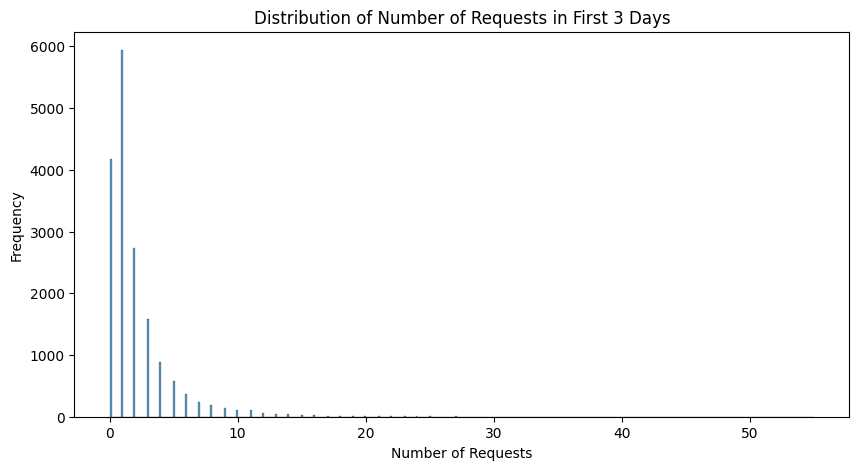

In [33]:
# Show a histogram of the number of requests in the first 3 days for custom_data
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10, 5))
sns.histplot(custom_data, x="request_day_within_3_days")
plt.title('Distribution of Number of Requests in First 3 Days')
plt.xlabel('Number of Requests')
plt.ylabel('Frequency')
plt.show()


Generated a count plot for each category within 3 days using the 'custom_data' DataFrame, displayed vertically, with Matplotlib and Seaborn for visualization.

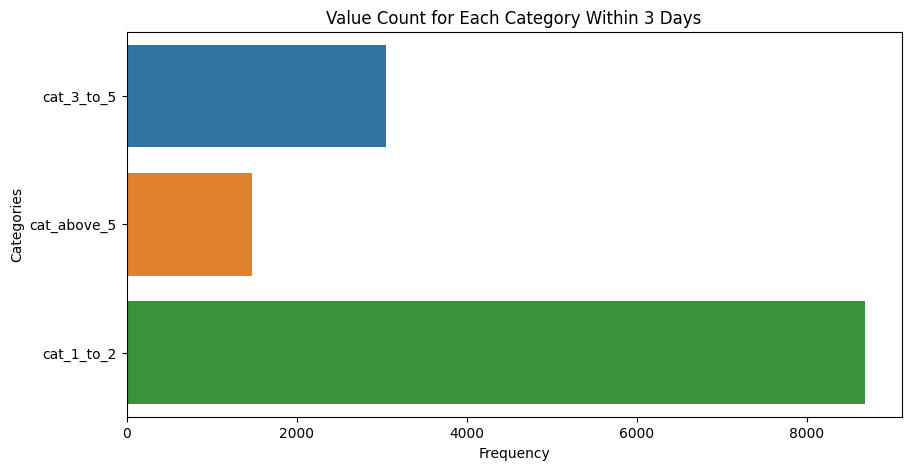

In [34]:
# Show a count plot for each category within 3 days in custom_data
plt.figure(figsize=(10, 5))
sns.countplot(y=custom_data['categories_3day'])
plt.title('Value Count for Each Category Within 3 Days')
plt.xlabel('Frequency')
plt.ylabel('Categories')
plt.show()


Separated 'custom_data' into categorical and numeric columns, printing the names of the categorical and numeric columns.

In [36]:
# Get categorical columns from custom_data
categorical_data = custom_data.select_dtypes(include=['object'])

# Get numeric columns from custom_data
numeric_data = custom_data.select_dtypes(exclude=['object'])

# Print the names of categorical columns
print("Categorical Columns: \n", list(categorical_data.columns))

# Print the names of numeric columns
print("Numeric Columns: \n", list(numeric_data.columns))


Categorical Columns: 
 ['type', 'furnishing', 'lease_type', 'parking', 'building_type', 'categories_7day', 'categories_3day']
Numeric Columns: 
 ['bathroom', 'floor', 'total_floor', 'gym', 'lift', 'property_age', 'property_size', 'swimming_pool', 'rent', 'deposit', 'photo_count', 'request_day_within_7_days', 'request_day_within_3_days']


Displayed all unique values and their counts for each categorical column in 'custom_data,' excluding the last two columns.

In [37]:
# Show all values and get count of them in every categorical column
for col in categorical_data.columns[:-2]:
    print('Column Name:', col)
    print(categorical_data[col].value_counts())
    print('\n---------------------------')


Column Name: type
BHK2        8510
BHK1        4508
BHK3        2691
RK1         1497
BHK4         157
BHK4PLUS      23
Name: type, dtype: int64

---------------------------
Column Name: furnishing
SEMI_FURNISHED     13523
NOT_FURNISHED       2917
FULLY_FURNISHED      946
Name: furnishing, dtype: int64

---------------------------
Column Name: lease_type
FAMILY      8401
ANYONE      8026
BACHELOR     928
COMPANY       31
Name: lease_type, dtype: int64

---------------------------
Column Name: parking
TWO_WHEELER     8059
BOTH            7771
NONE             921
FOUR_WHEELER     635
Name: parking, dtype: int64

---------------------------
Column Name: building_type
IF    10171
AP     6000
IH     1177
Name: building_type, dtype: int64

---------------------------


Generated count plots for each value in every categorical column, excluding the last two columns, using the 'custom_data' DataFrame and Matplotlib/Seaborn for visualization.

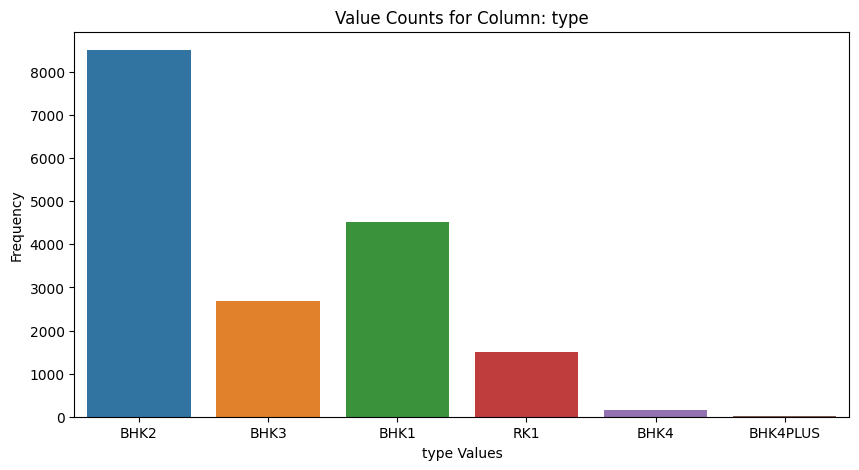

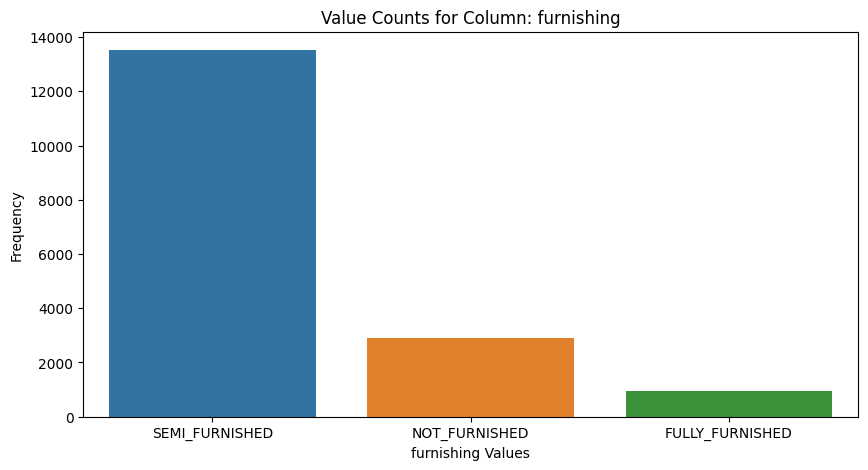

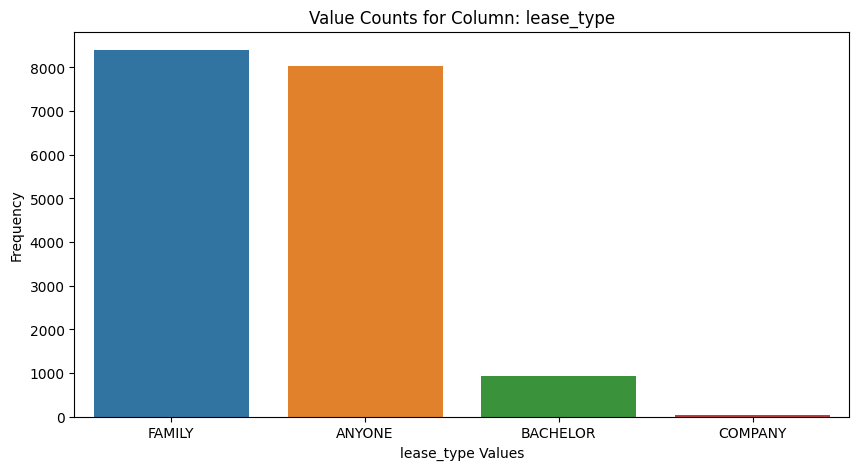

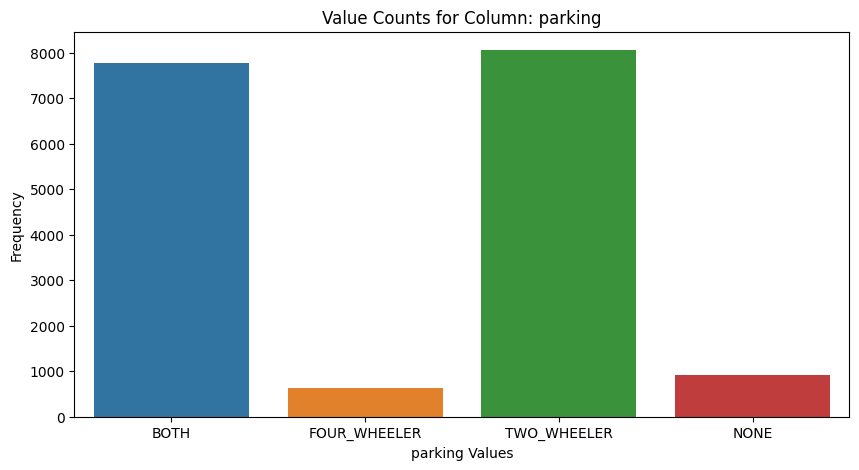

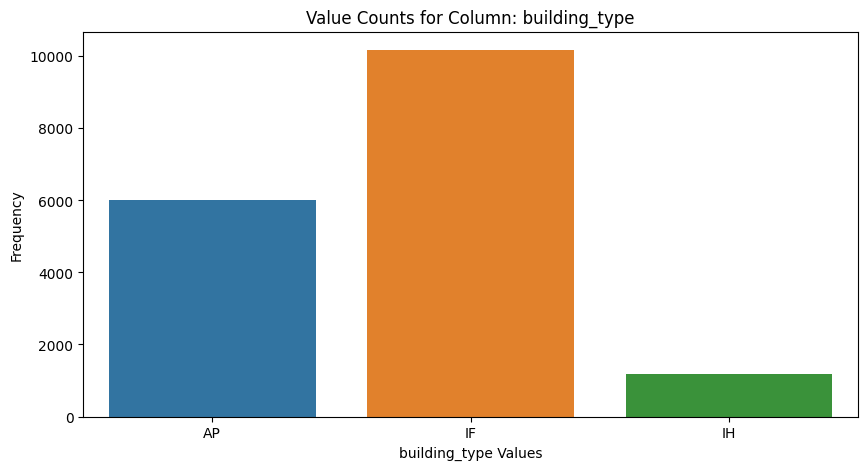

In [38]:
# Plot count of values in every column
for col in categorical_data.columns[:-2]:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=col, data=custom_data)
    plt.title(f'Value Counts for Column: {col}')
    plt.xlabel(f'{col} Values')
    plt.ylabel('Frequency')
    plt.show()


Created a box plot to visualize the ranges of values and identify outliers for each numeric column in the 'numeric_data' DataFrame using Matplotlib.

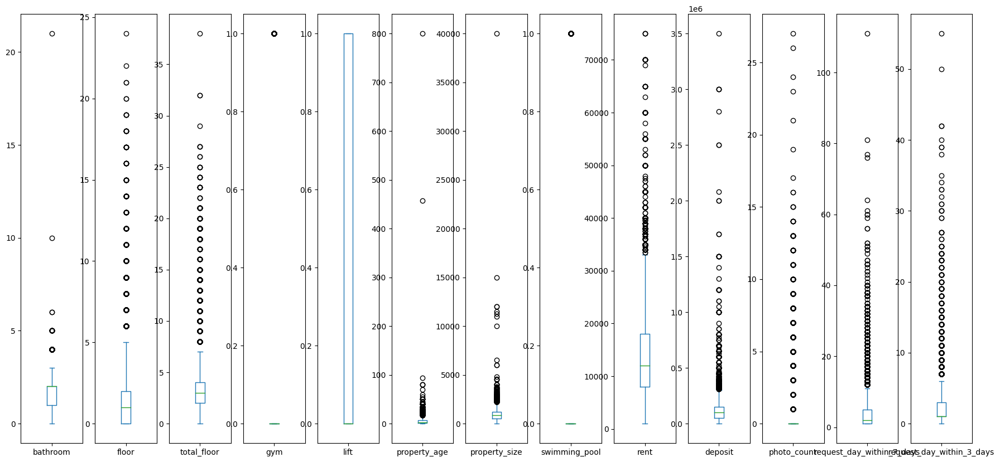

In [39]:
# Box Plot to show ranges of values and outliers for numeric columns
numeric_data.plot(kind='box', subplots=True, sharex=False, sharey=False, figsize=(22, 10))
plt.show()


# Feature Engineering

Defined a function 'filter_outliers_by_quantiles(df_in, col_name)' to remove outliers in a DataFrame based on the specified column using the interquartile range (IQR) method.

In [40]:
# Function to remove outliers using quantiles
def filter_outliers_by_quantiles(df_in, col_name):
    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3 - q1  # Interquartile range
    fence_low = q1 - 2 * iqr
    fence_high = q3 + 2 * iqr
    df_out = df_in.loc[(df_in[col_name] <= fence_high) & (df_in[col_name] >= fence_low)]
    return df_out


Created a new DataFrame 'df' by removing outliers from the 'custom_data' DataFrame for the specified numeric columns ('gym', 'lift', 'swimming_pool', 'request_day_within_3_days', 'request_day_within_7_days') using the 'filter_outliers_by_quantiles' function.

In [41]:
df = custom_data.copy()
for col in numeric_data.columns:
    if col in ['gym', 'lift', 'swimming_pool', 'request_day_within_3_days', 'request_day_within_7_days']:
        df = filter_outliers_by_quantiles(df, col)


Defined two functions, 'capping_for_3_days(x)' and 'capping_for_7_days(x),' to cap values at 10 and 20, respectively, for the specified purpose.

In [42]:
def capping_for_3_days(x):
    num = 10
    if x > num:
        return num
    else:
        return x

def capping_for_7_days(x):
    num = 20
    if x > num:
        return num
    else:
        return x


Applied the 'capping_for_3_days' function to cap values in the 'request_day_within_3_days' column at 10 and 'capping_for_7_days' function to cap values in the 'request_day_within_7_days' column at 20 in the 'df' DataFrame.

In [43]:
df['request_day_within_3d_capping'] = df['request_day_within_3_days'].apply(capping_for_3_days)
df['request_day_within_7d_capping'] = df['request_day_within_7_days'].apply(capping_for_7_days)


Generated a pair plot using Seaborn to visualize relationships between numeric features ('property_age', 'property_size', 'rent', 'deposit', 'photo_count') and the capped 'request_day_within_3d_capping' variable in the 'df' DataFrame.

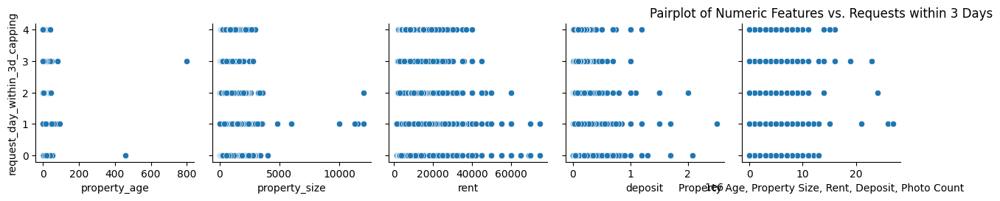

In [44]:
sns.pairplot(data=df,
             x_vars=['property_age', 'property_size', 'rent', 'deposit', 'photo_count'],
             y_vars=['request_day_within_3d_capping']
)

plt.title('Pairplot of Numeric Features vs. Requests within 3 Days')
plt.xlabel('Property Age, Property Size, Rent, Deposit, Photo Count')
plt.ylabel('Requests within 3 Days (Capped)')

plt.show()


Displayed a correlation heatmap for the numeric features in the 'df' DataFrame using Seaborn and Matplotlib for visualization.

/tmp/ipykernel_37742/897239771.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  dataplot = sns.heatmap(df.corr(), cmap="YlGnBu", annot=True)


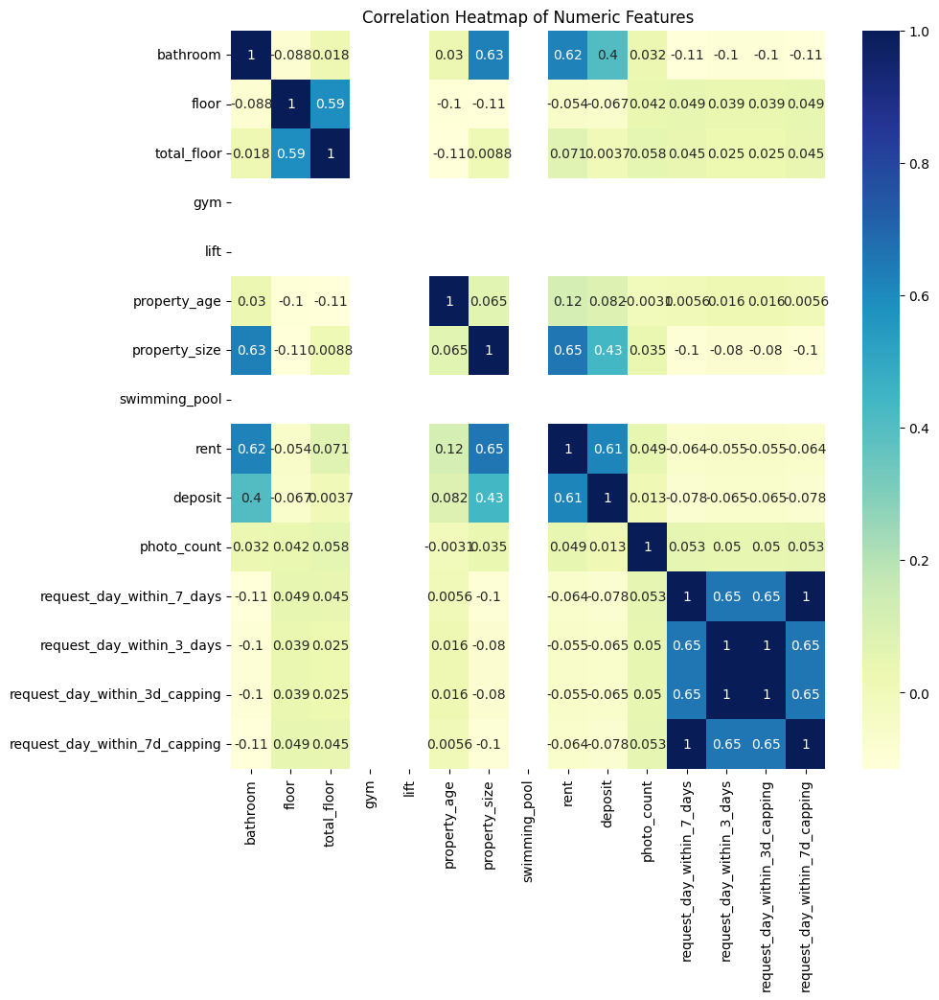

In [45]:
# Show a correlation heatmap
plt.subplots(figsize=(10, 10))
dataplot = sns.heatmap(df.corr(), cmap="YlGnBu", annot=True)

plt.title('Correlation Heatmap of Numeric Features')
plt.show()


## One-Hot Encoding

In [47]:
df

,type,bathroom,floor,total_floor,furnishing,gym,lease_type,lift,parking,property_age,...,rent,deposit,building_type,photo_count,request_day_within_7_days,categories_7day,request_day_within_3_days,categories_3day,request_day_within_3d_capping,request_day_within_7d_capping
16,BHK1,1,1,3.0,SEMI_FURNISHED,0,ANYONE,0,TWO_WHEELER,1,...,8000,50000,IF,0,1,cat_1_to_2,0.0,NaN,0.0,1
17,BHK2,2,0,2.0,SEMI_FURNISHED,0,FAMILY,0,TWO_WHEELER,4,...,18000,100000,AP,4,4,cat_3_to_5,0.0,NaN,0.0,4
19,BHK2,2,0,2.0,NOT_FURNISHED,0,FAMILY,0,BOTH,6,...,17000,100000,IH,5,5,cat_3_to_5,4.0,cat_3_to_5,4.0,5
20,RK1,1,3,3.0,NOT_FURNISHED,0,FAMILY,0,BOTH,0,...,7000,30000,IF,5,4,cat_3_to_5,1.0,cat_1_to_2,1.0,4
22,BHK2,2,0,5.0,SEMI_FURNISHED,0,FAMILY,0,TWO_WHEELER,5,...,12000,120000,AP,4,1,cat_1_to_2,1.0,cat_1_to_2,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17375,BHK1,1,2,3.0,NOT_FURNISHED,0,ANYONE,0,TWO_WHEELER,15,...,6000,60000,AP,0,3,cat_3_to_5,1.0,cat_1_to_2,1.0,3
17377,RK1,1,4,5.0,NOT_FURNISHED,0,ANYONE,0,TWO_WHEELER,0,...,7500,30000,AP,0,2,cat_1_to_2,1.0,cat_1_to_2,1.0,2
17378,BHK3,3,1,2.0,SEMI_FURNISHED,0,ANYONE,0,BOTH,15,...,26000,100000,IF,7,4,cat_3_to_5,1.0,cat_1_to_2,1.0,4
17380,BHK2,1,1,2.0,SEMI_FURNISHED,0,FAMILY,0,BOTH,45,...,25000,200000,IF,5,2,cat_1_to_2,2.0,cat_1_to_2,2.0,2


Separated the data into categorical ('features_categorical'), numeric ('features_numeric' and 'features_remain'), and target variable ('target_variables') sets for further processing.

In [49]:
# One-Hot Encoder for categorical values
# Dividing data into categorical, numeric, and label
features_numeric = df.drop(['request_day_within_7_days', 'categories_7day', 'request_day_within_3_days',
                            'categories_3day', 'request_day_within_3d_capping',
                            'request_day_within_7d_capping'], axis=1)

features_categorical = df[features_numeric.select_dtypes(include=['O']).columns]
features_remain = df[features_numeric.select_dtypes(exclude=['O']).columns]

target_variables = df[['request_day_within_7_days', 'categories_7day', 'request_day_within_3_days',
                       'categories_3day', 'request_day_within_3d_capping',
                       'request_day_within_7d_capping']]


Initialized empty DataFrames 'x_remain' and 'x_cat' for storing the remaining numeric features and categorical features, respectively.

In [50]:
# Create empty DataFrames for remaining numeric features and categorical features
x_remain = pd.DataFrame()
x_cat = pd.DataFrame()


Filled null values in the remaining numeric columns with the mean and in the categorical columns with the mode, storing the results in the 'x_remain' and 'x_cat' DataFrames, respectively.

In [51]:
# Handling Null values
# If we have null values in numeric columns, fill them with the mean (average)
for col in features_remain.columns:
    x_remain[col] = features_remain[col].fillna((features_remain[col].mean()))

# If we have null values in categorical columns, fill them with the mode
for col in features_categorical.columns:
    x_cat[col] = features_categorical[col].fillna(features_categorical[col].mode()[0])


Utilized the OneHotEncoder from scikit-learn to transform categorical features in the 'x_cat_reset_index' DataFrame, resulting in a new DataFrame 'df_features' with the transformed features.

In [58]:
from sklearn.preprocessing import OneHotEncoder

# Reset the index of x_cat DataFrame
x_cat_reset_index = x_cat.reset_index(drop=True)

# Create an instance of OneHotEncoder
ohe = OneHotEncoder(categories='auto', handle_unknown='ignore')

# Transform categorical features using OneHotEncoder
feature_train = ohe.fit_transform(x_cat_reset_index).toarray()

# Create a DataFrame with the transformed features
df_features = pd.DataFrame(feature_train, columns=ohe.get_feature_names_out(x_cat_reset_index.columns))


In [59]:
df_features

,type_BHK1,type_BHK2,type_BHK3,type_BHK4,type_BHK4PLUS,type_RK1,furnishing_FULLY_FURNISHED,furnishing_NOT_FURNISHED,furnishing_SEMI_FURNISHED,lease_type_ANYONE,lease_type_BACHELOR,lease_type_COMPANY,lease_type_FAMILY,parking_BOTH,parking_FOUR_WHEELER,parking_NONE,parking_TWO_WHEELER,building_type_AP,building_type_IF,building_type_IH
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10999,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
11000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
11001,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
11002,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


## MinMaxScaler

Utilized MinMaxScaler from scikit-learn to scale the remaining numeric features in 'x_remain,' resulting in a new DataFrame 'x_remain_scaled' with the scaled features.

In [61]:
from sklearn.preprocessing import MinMaxScaler

# Create an instance of MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the remaining numeric features
x_remain_scaled = scaler.fit_transform(x_remain)

# Convert the scaled array to a DataFrame with the original column names
x_remain_scaled = pd.DataFrame(x_remain_scaled, columns=x_remain.columns)
x_remain_scaled.head()

,bathroom,floor,total_floor,gym,lift,property_age,property_size,swimming_pool,rent,deposit,photo_count
0,0.047619,0.058824,0.142857,0.0,0.0,0.00125,0.041667,0.0,0.094595,0.020,0.000000
1,0.095238,0.000000,0.095238,0.0,0.0,0.00500,0.116667,0.0,0.229730,0.040,0.148148
2,0.095238,0.000000,0.095238,0.0,0.0,0.00750,0.075000,0.0,0.216216,0.040,0.185185
3,0.047619,0.176471,0.142857,0.0,0.0,0.00000,0.041667,0.0,0.081081,0.012,0.185185
4,0.095238,0.000000,0.238095,0.0,0.0,0.00625,0.100000,0.0,0.148649,0.048,0.148148


Concatenated the transformed categorical features ('df_features'), scaled numeric features ('x_remain_scaled'), and target variables ('target_variables') into a new DataFrame ('data_with_3days'). Any rows with missing values were dropped, resulting in the final shape of the DataFrame.

In [79]:
# Concatenate data after applying One-Hot Encoding
data_with_3days = pd.concat([df_features.reset_index(drop=True), x_remain_scaled.reset_index(drop=True),target_variables.reset_index(drop=True)], axis=1)
data_with_3days.dropna(inplace=True)
data_with_3days.shape

(8058, 37)

In [81]:
target_variables

,request_day_within_7_days,categories_7day,request_day_within_3_days,categories_3day,request_day_within_3d_capping,request_day_within_7d_capping
16,1,cat_1_to_2,0.0,NaN,0.0,1
17,4,cat_3_to_5,0.0,NaN,0.0,4
19,5,cat_3_to_5,4.0,cat_3_to_5,4.0,5
20,4,cat_3_to_5,1.0,cat_1_to_2,1.0,4
22,1,cat_1_to_2,1.0,cat_1_to_2,1.0,1
...,...,...,...,...,...,...
17375,3,cat_3_to_5,1.0,cat_1_to_2,1.0,3
17377,2,cat_1_to_2,1.0,cat_1_to_2,1.0,2
17378,4,cat_3_to_5,1.0,cat_1_to_2,1.0,4
17380,2,cat_1_to_2,2.0,cat_1_to_2,2.0,2


Concatenated the transformed categorical features ('df_features'), scaled numeric features ('x_remain_scaled'), and target variables ('target_variables') into a new DataFrame ('data_with_7days'). Rows with missing values were dropped, and the shape of the resulting DataFrame was displayed.

In [82]:
# Concatenate data after applying One-Hot Encoding
data_with_7days = pd.concat([df_features.reset_index(drop=True), x_remain_scaled.reset_index(drop=True), target_variables.reset_index(drop=True)], axis=1)

# Drop rows with missing values
data_with_7days.dropna(inplace=True)

# Display the shape of the resulting DataFrame
print(data_with_7days.shape)


(8058, 37)


# Model Traning and Predictions

## Predicting Interactions With 3 Days

In [83]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, mean_squared_error
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb

Assigned the features (X) and target variables (y) for the dataset 'data_with_3days,' excluding specific columns. The target variables include 'request_day_within_3_days' and 'request_day_within_3d_capping.'

In [93]:
X = data_with_3days.drop(['request_day_within_3_days',
'request_day_within_3d_capping',
'categories_3day', 'categories_7day', 'categories_3day'], axis=1)
y = data_with_3days[['request_day_within_3_days', 'request_day_within_3d_capping',]]

In [94]:
X

,type_BHK1,type_BHK2,type_BHK3,type_BHK4,type_BHK4PLUS,type_RK1,furnishing_FULLY_FURNISHED,furnishing_NOT_FURNISHED,furnishing_SEMI_FURNISHED,lease_type_ANYONE,...,gym,lift,property_age,property_size,swimming_pool,rent,deposit,photo_count,request_day_within_7_days,request_day_within_7d_capping
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.00750,0.075000,0.0,0.216216,0.040,0.185185,5,5
3,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.00000,0.041667,0.0,0.081081,0.012,0.185185,4,4
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.00625,0.100000,0.0,0.148649,0.048,0.148148,1,1
5,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.01875,0.091667,0.0,0.364865,0.112,0.000000,3,3
7,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.00875,0.045833,0.0,0.175676,0.024,0.148148,7,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10999,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.01875,0.041667,0.0,0.067568,0.024,0.000000,3,3
11000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.00000,0.033333,0.0,0.087838,0.012,0.000000,2,2
11001,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.01875,0.125000,0.0,0.337838,0.040,0.259259,4,4
11002,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.05625,0.083333,0.0,0.324324,0.080,0.185185,2,2


#### First Iteration with request_day_within_3_days columns
Split the data into training and testing sets and applied various regression models, including Linear Regression, Lasso Regression, K-Nearest Neighbors, Decision Tree Regressor, and XGBoost Regressor. Calculated and printed the Root Mean Square (RMS) error for each model.

In [95]:

# Split data into train and test sets
seed = 42
X_train, X_test, y_train, y_test = train_test_split(X, y['request_day_within_3_days'], test_size=0.2, random_state=seed)

# Try to make a model with these algorithms
models = []
models.append(('LR', LinearRegression()))
models.append(('LASSO', Lasso(random_state=seed)))
models.append(('KNN', KNeighborsRegressor()))
models.append(('CART', DecisionTreeRegressor(random_state=seed)))
models.append(('XGB', xgb.XGBRegressor(random_state=seed)))

results = []
names = []

for name, model in models:
    # Create the model
    regressor = model
    
    # Fit the model with training data
    regressor.fit(X_train, y_train)
    
    # Predict after training
    y_pred = regressor.predict(X_test)
    
    # Calculate root mean square error
    rms = np.sqrt(mean_squared_error(y_test, y_pred))
    
    msg = f"{name}: RMS => {rms}"
    print(msg)


LR: RMS => 0.7473847373401841
LASSO: RMS => 0.8804071442537215
KNN: RMS => 0.7808343186941903
CART: RMS => 0.9966600551385035
XGB: RMS => 0.768453416597908


#### Second Iteration with request_day_within_3d_capping column

Split the data into training and testing sets and applied various regression models, including Linear Regression, Lasso Regression, K-Nearest Neighbors, Decision Tree Regressor, and XGBoost Regressor. Calculated and printed the Root Mean Square (RMS) error for each model, focusing on the target variable 'request_day_within_3d_capping.'

In [96]:
# Split data into train and test sets
seed = 42
X_train, X_test, y_train, y_test = train_test_split(X, y['request_day_within_3d_capping'], test_size=0.2, random_state=seed)

# Try to make a model with these algorithms
models = []
models.append(('LR', LinearRegression()))
models.append(('LASSO', Lasso(random_state=seed)))
models.append(('KNN', KNeighborsRegressor()))
models.append(('CART', DecisionTreeRegressor(random_state=seed)))
models.append(('XGB', xgb.XGBRegressor(random_state=seed)))

results = []
names = []

for name, model in models:
    # Create the model
    regressor = model
    
    # Fit the model with training data
    regressor.fit(X_train, y_train)
    
    # Predict after training
    y_pred = regressor.predict(X_test)
    
    # Calculate root mean square error
    rms = np.sqrt(mean_squared_error(y_test, y_pred))
    
    msg = f"{name}: RMS => {rms}"
    print(msg)

LR: RMS => 0.7473847373401841
LASSO: RMS => 0.8804071442537215
KNN: RMS => 0.7808343186941903
CART: RMS => 0.9966600551385035
XGB: RMS => 0.768453416597908


In [98]:
X

,type_BHK1,type_BHK2,type_BHK3,type_BHK4,type_BHK4PLUS,type_RK1,furnishing_FULLY_FURNISHED,furnishing_NOT_FURNISHED,furnishing_SEMI_FURNISHED,lease_type_ANYONE,...,gym,lift,property_age,property_size,swimming_pool,rent,deposit,photo_count,request_day_within_7_days,request_day_within_7d_capping
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.00750,0.075000,0.0,0.216216,0.040,0.185185,5,5
3,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.00000,0.041667,0.0,0.081081,0.012,0.185185,4,4
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.00625,0.100000,0.0,0.148649,0.048,0.148148,1,1
5,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.01875,0.091667,0.0,0.364865,0.112,0.000000,3,3
7,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.00875,0.045833,0.0,0.175676,0.024,0.148148,7,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10999,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.01875,0.041667,0.0,0.067568,0.024,0.000000,3,3
11000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.00000,0.033333,0.0,0.087838,0.012,0.000000,2,2
11001,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.01875,0.125000,0.0,0.337838,0.040,0.259259,4,4
11002,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.05625,0.083333,0.0,0.324324,0.080,0.185185,2,2


## Predicting Interactions With 7 Days

#### First Iteration with request_day_within_3_days columns
Assigned the features (X) and target variables (y) for the dataset 'data_with_7days,' excluding specific columns. The target variables include 'request_day_within_3_days' and 'request_day_within_3d_capping.'

In [103]:
X = data_with_7days.drop(['request_day_within_3_days',
'request_day_within_3d_capping',
'categories_3day', 'categories_7day', 'categories_3day'], axis=1)
y = data_with_7days[['request_day_within_3_days', 'request_day_within_3d_capping',]]

Split the data into training and testing sets and applied various regression models, including Linear Regression, Lasso Regression, K-Nearest Neighbors, Decision Tree Regressor, and XGBoost Regressor. Calculated and printed the Root Mean Square (RMS) error for each model, focusing on the target variable 'request_day_within_3_days' from the dataset 'data_with_7days.'

In [104]:
# Split data into train and test sets
seed = 42
X_train, X_test, y_train, y_test = train_test_split(X, y['request_day_within_3_days'], test_size=0.2, random_state=seed)

# Try to make a model with these algorithms
models = []
models.append(('LR', LinearRegression()))
models.append(('LASSO', Lasso(random_state=seed)))
models.append(('KNN', KNeighborsRegressor()))
models.append(('CART', DecisionTreeRegressor(random_state=seed)))
models.append(('XGB', xgb.XGBRegressor(random_state=seed)))

results = []
names = []

for name, model in models:
    # Create the model
    regressor = model
    
    # Fit the model with training data
    regressor.fit(X_train, y_train)
    
    # Predict after training
    y_pred = regressor.predict(X_test)
    
    # Calculate root mean square error
    rms = np.sqrt(mean_squared_error(y_test, y_pred))
    
    msg = f"{name}: RMS => {rms}"
    print(msg)


LR: RMS => 0.7473847373401841
LASSO: RMS => 0.8804071442537215
KNN: RMS => 0.7808343186941903
CART: RMS => 0.9966600551385035
XGB: RMS => 0.768453416597908


#### First Iteration with request_day_within_3_days columns
Split the data into training and testing sets and applied various regression models, including Linear Regression, Lasso Regression, K-Nearest Neighbors, Decision Tree Regressor, and XGBoost Regressor. Calculated and printed the Root Mean Square (RMS) error for each model, focusing on the target variable 'request_day_within_3d_capping' from the dataset 'data_with_7days.'

In [105]:
# Split data into train and test sets
seed = 42
X_train, X_test, y_train, y_test = train_test_split(X, y['request_day_within_3d_capping'], test_size=0.2, random_state=seed)

# Try to make a model with these algorithms
models = []
models.append(('LR', LinearRegression()))
models.append(('LASSO', Lasso(random_state=seed)))
models.append(('KNN', KNeighborsRegressor()))
models.append(('CART', DecisionTreeRegressor(random_state=seed)))
models.append(('XGB', xgb.XGBRegressor(random_state=seed)))

results = []
names = []

for name, model in models:
    # Create the model
    regressor = model
    
    # Fit the model with training data
    regressor.fit(X_train, y_train)
    
    # Predict after training
    y_pred = regressor.predict(X_test)
    
    # Calculate root mean square error
    rms = np.sqrt(mean_squared_error(y_test, y_pred))
    
    msg = f"{name}: RMS => {rms}"
    print(msg)

LR: RMS => 0.7473847373401841
LASSO: RMS => 0.8804071442537215
KNN: RMS => 0.7808343186941903
CART: RMS => 0.9966600551385035
XGB: RMS => 0.768453416597908


# Deep Learning

Created a Sequential Artificial Neural Network (ANN) model using Keras with two hidden layers of 512 neurons and a linear activation output layer. Compiled the model using the Adam optimizer and mean squared error loss. Trained the model for 50 epochs and visualized the training and validation loss over epochs using Matplotlib.

Epoch 1/50
202/202 [==============================] - 1s 4ms/step - loss: 0.6066 - val_loss: 0.5352
Epoch 2/50
202/202 [==============================] - 1s 3ms/step - loss: 0.5114 - val_loss: 0.5271
Epoch 3/50
202/202 [==============================] - 1s 3ms/step - loss: 0.5159 - val_loss: 0.5393
Epoch 4/50
202/202 [==============================] - 1s 3ms/step - loss: 0.4969 - val_loss: 0.5638
Epoch 5/50
202/202 [==============================] - 1s 3ms/step - loss: 0.5069 - val_loss: 0.5247
Epoch 6/50
202/202 [==============================] - 1s 3ms/step - loss: 0.4979 - val_loss: 0.5336
Epoch 7/50
202/202 [==============================] - 1s 3ms/step - loss: 0.4960 - val_loss: 0.5273
Epoch 8/50
202/202 [==============================] - 1s 3ms/step - loss: 0.4915 - val_loss: 0.5255
Epoch 9/50
202/202 [==============================] - 1s 3ms/step - loss: 0.4988 - val_loss: 0.5344
Epoch 10/50
202/202 [==============================] - 1s 3ms/step - loss: 0.4873 - val_loss: 0.5268

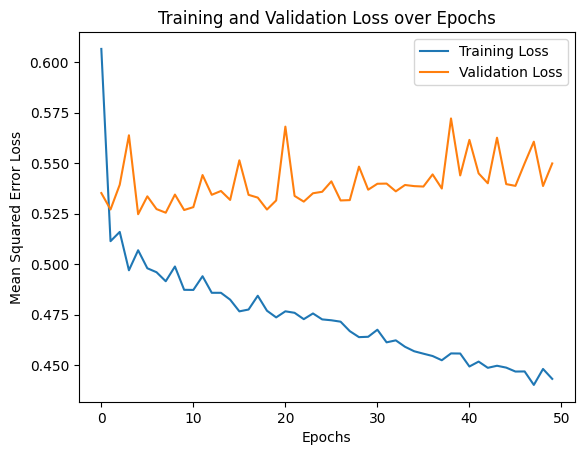

In [109]:
from keras.models import Sequential
from keras.layers import Dense
import matplotlib.pyplot as plt

# Create ANN model
model = Sequential()
model.add(Dense(512, activation='relu', input_shape=(X_train.shape[1],)))
model.add(Dense(512, activation='relu'))
model.add(Dense(1, activation='linear'))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model and collect training history
history = model.fit(X_train, y_train, epochs=50, verbose=1, validation_data=(X_test, y_test))

# Plot the training loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error Loss')
plt.legend()
plt.show()


# Concluding Observations
* In this code exploration, various data preprocessing and modeling steps were performed on a real estate dataset. Key tasks included data cleaning, feature engineering, handling null values, encoding categorical variables, and splitting the data into training and testing sets. Several regression models, both traditional (Linear Regression, Lasso, K-Nearest Neighbors, Decision Tree) and advanced (XGBoost), were applied to predict the number of requests within the first 3 days and its capped version. Additionally, a neural network using Keras was constructed and trained for the same prediction task.

* Insights from the correlation heatmap and pair plots were used to understand the relationships between features. The dataset was categorized and outliers were addressed through quantiles filtering. Various visualizations, such as histograms and count plots, were employed to explore the distribution of requests and categorical values.

* The choice of models revealed differing performance in predicting the target variables, with root mean square error (RMS) used as the evaluation metric. The results indicated that the performance of the models varied, and the neural network exhibited competitive performance.

* In conclusion, this analysis showcased a comprehensive approach to data preprocessing, model selection, and evaluation in a real estate context. The choice of the most suitable model may depend on the specific goals and characteristics of the dataset. The neural network, being a powerful tool, demonstrated its potential in capturing complex patterns in the data. Further refinement and tuning of models could be explored to enhance predictive accuracy.